In [2]:
import transformers
from transformers import AutoTokenizer, AutoModelForCausalLM
import sys
sys.path.append("/home/shaoyuantian/program/MixedPrecision/fake_quant")
import rotation_utils

model = AutoModelForCausalLM.from_pretrained("meta-llama/Meta-Llama-3-8B",
                                             device_map="cpu",
                                             torch_dtype="auto")
rotation_utils.fuse_layer_norms(model)


Loading checkpoint shards: 100%|██████████| 4/4 [00:00<00:00, 11.76it/s]


In [4]:
class Args():
    def __init__(self):
        self.use_r1 = True
        self.use_r2 = "offline"
        self.use_r3 = False
        self.use_r4 = True
        self.r1_path = None
        self.r2_path = None
        self.rotate_mode = "hadamard"
        self.smooth = None
args = Args()
rotation_utils.rotate_model(model, args)

Rotating: 100%|██████████| 32/32 [01:00<00:00,  1.89s/layer]


In [5]:
import torch
import numpy as np
import matplotlib.pyplot as plt

def plot_3d_matrix(org_w,
                   title='3D Matrix Visualization',
                   xlabel='input',
                   ylabel='output',
                   zlabel='Intensity',
                   cmap='coolwarm'):
    """
    将输入的矩阵进行 3D 可视化。

    参数:
    org_w: 2D numpy 数组 或 torch.Tensor，表示要可视化的矩阵
    xlabel: X 轴的标签
    ylabel: Y 轴的标签
    zlabel: Z 轴的标签
    cmap: 颜色映射，默认 'coolwarm'
    """
    # 如果输入是 torch.Tensor，转换为 numpy.ndarray
    if isinstance(org_w, torch.Tensor):
        org_w = org_w.numpy()

    # 确保输入是二维矩阵
    if not isinstance(org_w, np.ndarray) or org_w.ndim != 2:
        raise ValueError("org_w 必须是一个二维矩阵（numpy array 或 torch tensor）。")

    M, N = org_w.shape
    X = np.arange(N)
    Y = np.arange(M)
    X, Y = np.meshgrid(X, Y)

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # 绘制 3D 表面图
    ax.plot_surface(X, Y, org_w, cmap=cmap)

    # 设置坐标轴标签
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_zlabel(zlabel)
    ax.title.set_text(f'{title}')

    plt.show()

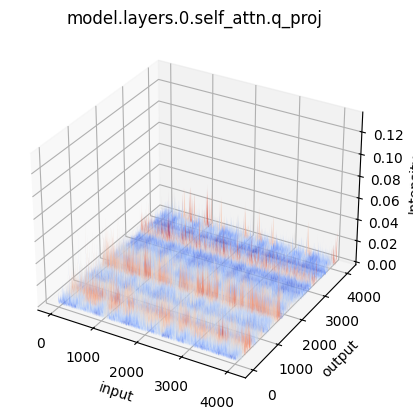

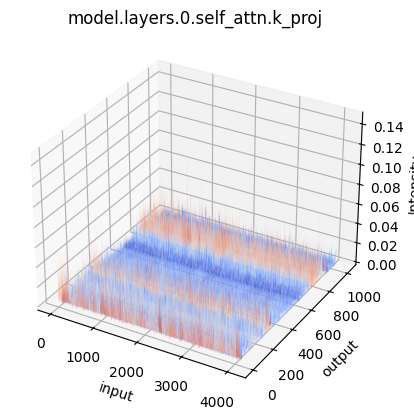

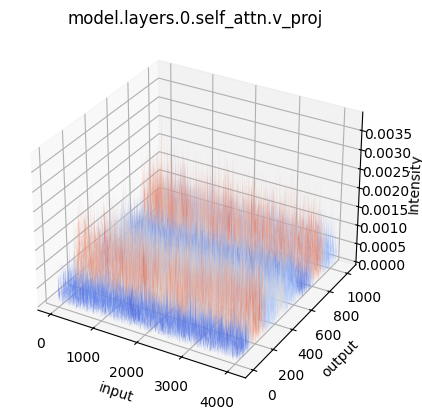

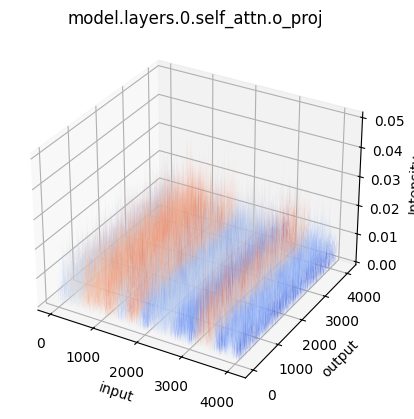

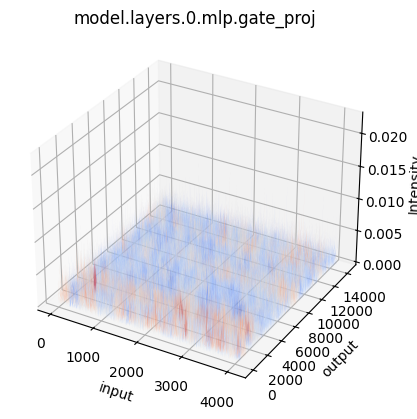

...

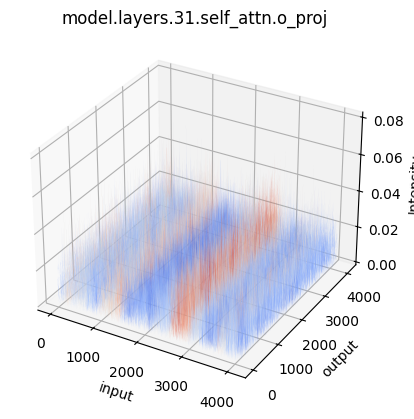

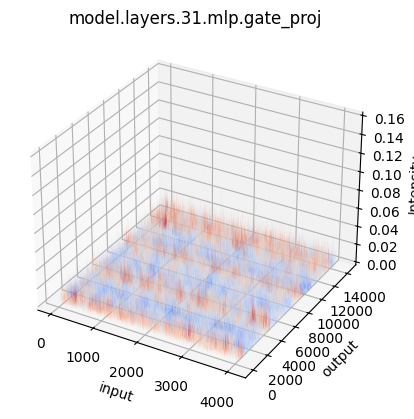

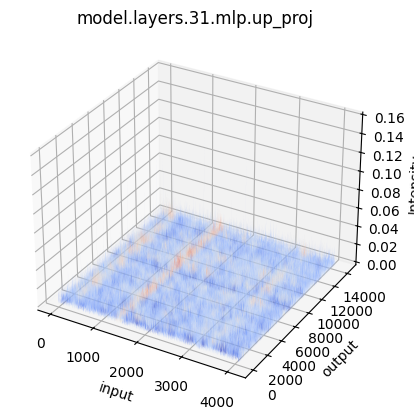

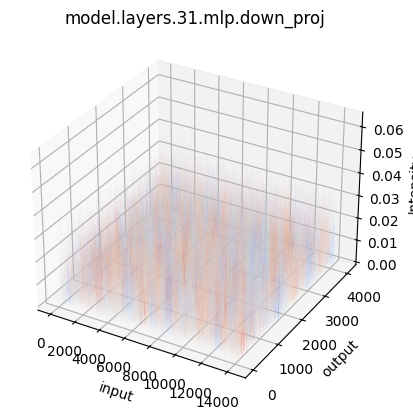

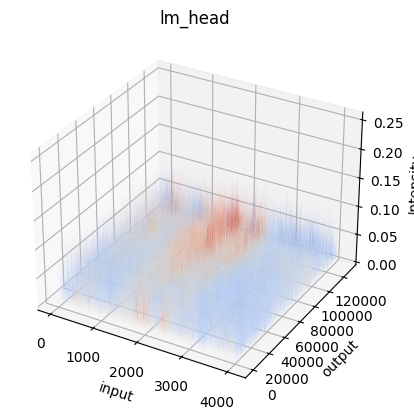

In [6]:
# names = ['q_proj', 'k_proj', 'v_proj', 'o_proj', 'up_proj', 'gate_proj']
for name, moudle in model.named_modules():
    if isinstance(moudle, torch.nn.Linear):
        weight = moudle.weight.data.to(dtype=torch.float32, device='cpu').abs()
        plot_3d_matrix(weight,
                    title=name,
                    xlabel='input',
                    ylabel='output',
                    zlabel='Intensity',
                    cmap='coolwarm')